<a href="https://colab.research.google.com/github/ajaysuseel/MiniProject_AD/blob/main/Finetuning/finetuning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch
import json
import requests
from PIL import Image
from torch.utils.data import Dataset, DataLoader
from transformers import BlipProcessor, BlipForConditionalGeneration
import torch.nn.functional as F
from tqdm import tqdm


#CONFIGURABLE VARIABLES

In [ ]:
# Configurable variables
GITHUB_REPO = "https://raw.githubusercontent.com/ajaysuseel/MiniProject_AD/main/data/"
JSON_FILE = "captions.json"
IMAGES_FOLDER = "images/"

#Function: Load BLIP Model

In [ ]:
def load_blip_model():
    model_name = "Salesforce/blip-image-captioning-base"
    processor = BlipProcessor.from_pretrained(model_name)
    model = BlipForConditionalGeneration.from_pretrained(model_name)
    return model, processor

#Function: Load Dataset from GitHub

In [ ]:
def load_dataset():
    json_url = GITHUB_REPO + JSON_FILE
    try:
        response = requests.get(json_url)
        response.raise_for_status()
        data = response.json()
        print(f"Loaded {len(data)} image-caption pairs.")
        return data
    except requests.exceptions.RequestException as e:
        print(f"Error loading dataset: {e}")
        return []

#Custom Dataset Class

In [ ]:
class CaptionDataset(Dataset):
    def __init__(self, data, processor, images_dir):
        self.data = data
        self.processor = processor
        self.images_dir = images_dir

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        item = self.data[idx]
        image_url = self.images_dir + item["filename"]

        try:
            image = Image.open(requests.get(image_url, stream=True).raw).convert("RGB")
        except Exception as e:
            print(f"Error loading image {item['filename']}: {e}")
            return None

        encoding = self.processor(
            text=item["description"],
            images=image,
            return_tensors="pt",
            padding="max_length",
            truncation=True
        )
        encoding = {key: val.squeeze(0) for key, val in encoding.items()}
        encoding["labels"] = encoding["input_ids"]
        return encoding

#Create DataLoader

In [ ]:
def create_dataloader(data, processor, batch_size=4):
    dataset = CaptionDataset(data, processor, GITHUB_REPO + IMAGES_FOLDER)

    def collate_fn(batch):
        batch = [b for b in batch if b is not None]
        if len(batch) == 0:
            return None
        keys = batch[0].keys()
        return {key: torch.stack([b[key] for b in batch]) for key in keys}

    return DataLoader(dataset, batch_size=batch_size, shuffle=True, collate_fn=collate_fn)

#Train Model

In [ ]:
def train_blip(model, dataloader, num_epochs=3, learning_rate=5e-5):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    model.train()
    optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

    print(f"🚀 Starting fine-tuning on {device} for {num_epochs} epochs...")

    for epoch in range(num_epochs):
        epoch_loss = 0.0
        progress_bar = tqdm(dataloader, desc=f"Epoch {epoch+1}/{num_epochs}")

        for batch in progress_bar:
            optimizer.zero_grad()
            pixel_values = batch["pixel_values"].to(device)
            input_ids = batch["input_ids"].to(device)
            attention_mask = batch["attention_mask"].to(device)
            labels = batch["labels"].to(device)

            outputs = model(
                pixel_values=pixel_values,
                input_ids=input_ids,
                attention_mask=attention_mask,
                labels=labels
            )

            loss = outputs.loss
            loss.backward()
            optimizer.step()
            epoch_loss += loss.item()
            progress_bar.set_postfix(loss=loss.item())

        print(f"✅ Epoch {epoch+1} completed | Average Loss: {epoch_loss:.4f}")

    model.save_pretrained("./models/finetuned_blip1")
    processor.save_pretrained("./models/finetuned_blip1")
    print("🎯 Fine-tuning complete and model saved!")

In [ ]:
import os
os.environ["WANDB_DISABLED"] = "true"


In [ ]:
if __name__ == "__main__":
    model, processor = load_blip_model()
    data = load_dataset()

    if not data:
        print("No data found. Exiting.")
    else:
        dataloader = create_dataloader(data, processor)
        if dataloader is None:
            print("Error: No valid data samples found. Exiting.")
        else:
            train_blip(model, dataloader, num_epochs=20)


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/287 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/506 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/711k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/125 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.56k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/990M [00:00<?, ?B/s]

Loaded 127 image-caption pairs.
🚀 Starting fine-tuning on cuda for 20 epochs...


Epoch 1/20:   0%|          | 0/32 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/990M [00:00<?, ?B/s]

Epoch 1/20: 100%|██████████| 32/32 [01:16<00:00,  2.38s/it, loss=5.12]


✅ Epoch 1 completed | Average Loss: 231.3793


Epoch 2/20: 100%|██████████| 32/32 [01:01<00:00,  1.91s/it, loss=1.19]


✅ Epoch 2 completed | Average Loss: 95.4847


Epoch 3/20: 100%|██████████| 32/32 [00:55<00:00,  1.75s/it, loss=0.191]


✅ Epoch 3 completed | Average Loss: 15.0220


Epoch 4/20: 100%|██████████| 32/32 [00:52<00:00,  1.64s/it, loss=0.108]


✅ Epoch 4 completed | Average Loss: 3.9345


Epoch 5/20: 100%|██████████| 32/32 [00:51<00:00,  1.61s/it, loss=0.0801]


✅ Epoch 5 completed | Average Loss: 2.3753


Epoch 6/20: 100%|██████████| 32/32 [00:54<00:00,  1.69s/it, loss=0.0446]


✅ Epoch 6 completed | Average Loss: 1.6447


Epoch 7/20: 100%|██████████| 32/32 [00:57<00:00,  1.79s/it, loss=0.0412]


✅ Epoch 7 completed | Average Loss: 1.2283


Epoch 8/20: 100%|██████████| 32/32 [00:58<00:00,  1.82s/it, loss=0.0311]


✅ Epoch 8 completed | Average Loss: 0.9368


Epoch 9/20: 100%|██████████| 32/32 [00:56<00:00,  1.75s/it, loss=0.0193]


✅ Epoch 9 completed | Average Loss: 0.7213


Epoch 10/20: 100%|██████████| 32/32 [00:53<00:00,  1.68s/it, loss=0.0141]


✅ Epoch 10 completed | Average Loss: 0.5543


Epoch 11/20: 100%|██████████| 32/32 [00:52<00:00,  1.64s/it, loss=0.0119]


✅ Epoch 11 completed | Average Loss: 0.4381


Epoch 12/20: 100%|██████████| 32/32 [00:53<00:00,  1.67s/it, loss=0.0103]


✅ Epoch 12 completed | Average Loss: 0.3629


Epoch 13/20: 100%|██████████| 32/32 [00:55<00:00,  1.75s/it, loss=0.00815]


✅ Epoch 13 completed | Average Loss: 0.3040


Epoch 14/20: 100%|██████████| 32/32 [00:57<00:00,  1.80s/it, loss=0.00764]


✅ Epoch 14 completed | Average Loss: 0.2578


Epoch 15/20: 100%|██████████| 32/32 [00:56<00:00,  1.76s/it, loss=0.00667]


✅ Epoch 15 completed | Average Loss: 0.2288


Epoch 16/20: 100%|██████████| 32/32 [00:53<00:00,  1.69s/it, loss=0.00567]


✅ Epoch 16 completed | Average Loss: 0.2097


Epoch 17/20: 100%|██████████| 32/32 [00:52<00:00,  1.64s/it, loss=0.00519]


✅ Epoch 17 completed | Average Loss: 0.1864


Epoch 18/20: 100%|██████████| 32/32 [00:53<00:00,  1.68s/it, loss=0.00474]


✅ Epoch 18 completed | Average Loss: 0.1662


Epoch 19/20: 100%|██████████| 32/32 [00:54<00:00,  1.70s/it, loss=0.00444]


✅ Epoch 19 completed | Average Loss: 0.1500


Epoch 20/20: 100%|██████████| 32/32 [00:57<00:00,  1.78s/it, loss=0.00412]


✅ Epoch 20 completed | Average Loss: 0.1350
🎯 Fine-tuning complete and model saved!


#Gdrive

In [ ]:
import os
from google.colab import drive

# 🚀 Mount Google Drive
drive.mount('/content/drive')

# 🔄 Define source & destination paths
MODELS_SRC = "/content/models"
GDRIVE_DEST = "/content/drive/MyDrive/models"

# ✅ Copy models folder to Google Drive
if os.path.exists(MODELS_SRC):
    !cp -r {MODELS_SRC} {GDRIVE_DEST}
    print(f"✅ Models folder successfully copied to Google Drive: {GDRIVE_DEST}")
else:
    print("⚠️ No 'models' folder found in /content/. Please check your path.")


Mounted at /content/drive
✅ Models folder successfully copied to Google Drive: /content/drive/MyDrive/models


In [ ]:
from google.colab import drive
drive.flush_and_unmount()

In [ ]:
from google.colab import drive
import shutil
import os

# 🚀 Mount Google Drive
drive.mount('/content/drive')

# 🔹 Source (Google Drive folder)
src_folder = "/content/drive/MyDrive/models/models"

# 🔹 Destination (Colab models folder)
dest_folder = "/content/models"

# # 🗑️ Remove existing folder if it exists
# if os.path.exists(dest_folder):
#     shutil.rmtree(dest_folder)
#     print("⚠️ Existing 'models' folder deleted.")

# 🔄 Copy the folder from Drive
shutil.copytree(src_folder, dest_folder)
print("✅ Models folder copied successfully from Drive!")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
✅ Models folder copied successfully from Drive!


In [ ]:
# from google.colab import drive
# drive.flush_and_unmount()

#Evaluation

In [ ]:
from nltk.translate.bleu_score import sentence_bleu, corpus_bleu
import matplotlib.pyplot as plt

In [ ]:
import os
os.chdir('/content')  # Change to a known existing directory

!git clone https://github.com/ajaysuseel/MiniProject_AD.git

Cloning into 'MiniProject_AD'...
remote: Enumerating objects: 335, done.
remote: Counting objects: 100% (80/80), done.
remote: Compressing objects: 100% (73/73), done.
remote: Total 335 (delta 9), reused 71 (delta 7), pack-reused 255 (from 1)
Receiving objects: 100% (335/335), 72.60 MiB | 24.74 MiB/s, done.
Resolving deltas: 100% (77/77), done.


In [ ]:
IMAGE_FOLDER = "/content/MiniProject_AD/raw_data/pranav/images"  # Image folder
CAPTIONS_FILE = "/content/MiniProject_AD/raw_data/pranav/captions.json"  # JSON with filename-description
MODEL_PATH = "./models/finetuned_blip1"  # Fine-tuned BLIP model path

In [ ]:
def load_model_and_processor(model_path):
    try:
        processor = BlipProcessor.from_pretrained(model_path)
        model = BlipForConditionalGeneration.from_pretrained(model_path)
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        model.to(device)
        model.eval()
        print(f"✅ Model loaded on {device}")
        return model, processor, device
    except Exception as e:
        print(f"❌ Error loading model: {e}")
        return None, None, None
def load_ground_truth(local_json_path):
    try:
        with open(local_json_path, "r") as f:
            gt_data = json.load(f)
            gt_data = {item["filename"]: item["description"] for item in gt_data}
        print(f"✅ Loaded {len(gt_data)} ground truth captions.")
        return gt_data
    except Exception as e:
        print(f"❌ Error loading ground truth: {e}")
        return {}
def load_image(image_path):
    try:
        image = Image.open(image_path).convert("RGB")
        return image
    except Exception as e:
        print(f"❌ Error loading image {image_path}: {e}")
        return None


In [ ]:
def generate_caption(model, processor, device, image):
    try:
        inputs = processor(images=image, return_tensors="pt")
        inputs = {k: v.to(device) for k, v in inputs.items()}
        with torch.no_grad():
            output_ids = model.generate(**inputs)
        return processor.decode(output_ids[0], skip_special_tokens=True)
    except Exception as e:
        print(f"❌ Error generating caption: {e}")
        return ""

In [ ]:
def display_image_with_captions(image_path, gt_caption, generated_caption, bleu_score):
    image = load_image(image_path)
    if image is None:
        return
    plt.figure(figsize=(8, 6))
    plt.imshow(image)
    plt.axis("off")
    plt.title(f"GT: {gt_caption}\nGen: {generated_caption}\nBLEU: {bleu_score:.4f}", fontsize=10)
    plt.show()


In [ ]:
def evaluate_model(image_folder, gt_json_path, model_path):
    gt_captions = load_ground_truth(gt_json_path)
    if not gt_captions:
        print("❌ No ground truth data available. Exiting evaluation.")
        return

    model, processor, device = load_model_and_processor(model_path)
    if model is None:
        print("❌ Model loading failed. Exiting evaluation.")
        return

    generated_captions = {}
    references = []
    hypotheses = []

    image_files = [f for f in os.listdir(image_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    print(f"🔹 Found {len(image_files)} images in {image_folder}.")

    for filename in tqdm(image_files, desc="Evaluating Images"):
        if filename not in gt_captions:
            continue

        image_path = os.path.join(image_folder, filename)
        image = load_image(image_path)
        if image is None:
            continue

        gen_caption = generate_caption(model, processor, device, image)
        generated_captions[filename] = gen_caption

        # Compute BLEU score
        hypothesis = gen_caption.split()
        reference = [gt_captions[filename].split()]  # BLEU expects a list of references
        score = sentence_bleu(reference, hypothesis)

        # Store for corpus BLEU calculation
        references.append(reference)
        hypotheses.append(hypothesis)

        # Display image with captions
        display_image_with_captions(image_path, gt_captions[filename], gen_caption, score)

    # Compute Corpus BLEU Score
    corpus_bleu_score = corpus_bleu(references, hypotheses)
    print("\n--- Evaluation Summary ---")
    print(f"📊 Corpus BLEU Score: {corpus_bleu_score:.4f}")


✅ Loaded 60 ground truth captions.
✅ Model loaded on cuda
🔹 Found 59 images in /content/MiniProject_AD/raw_data/pranav/images.


Evaluating Images:   0%|          | 0/59 [00:00<?, ?it/s]

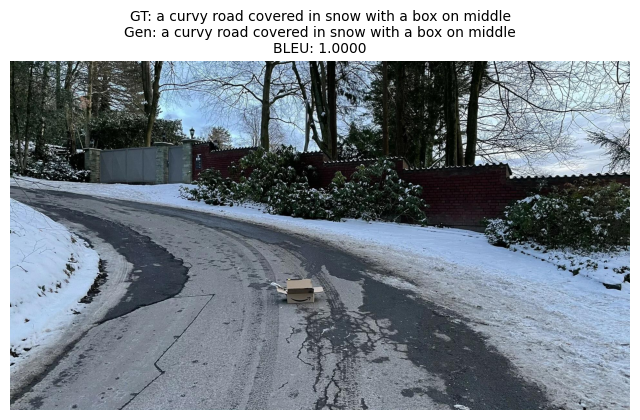

Evaluating Images:   2%|▏         | 1/59 [00:01<01:07,  1.16s/it]

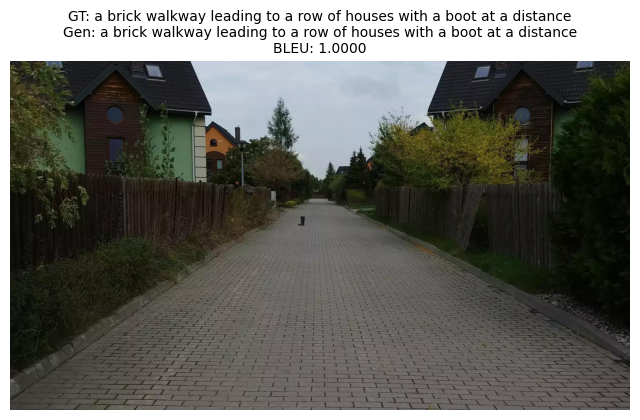

Evaluating Images:   3%|▎         | 2/59 [00:01<00:55,  1.04it/s]

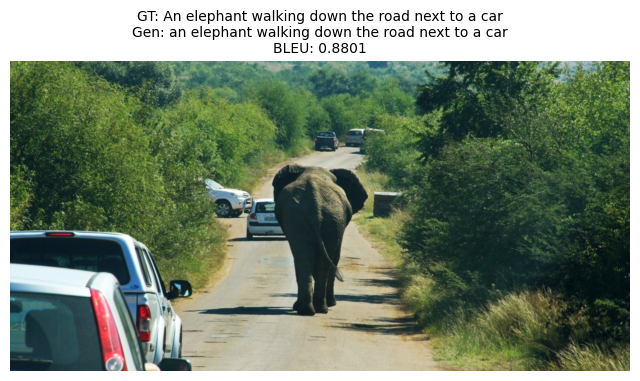

Evaluating Images:   5%|▌         | 3/59 [00:02<00:47,  1.19it/s]

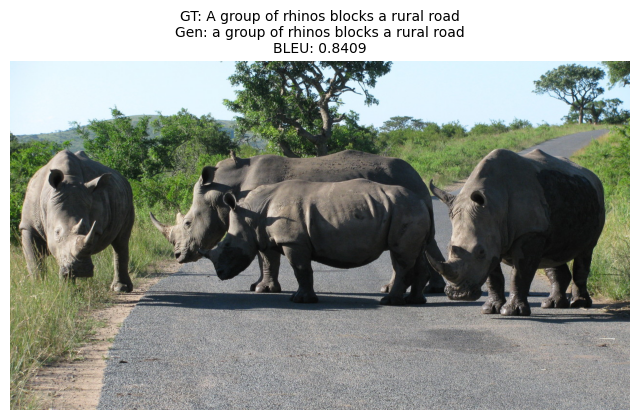

Evaluating Images:   7%|▋         | 4/59 [00:03<00:40,  1.36it/s]

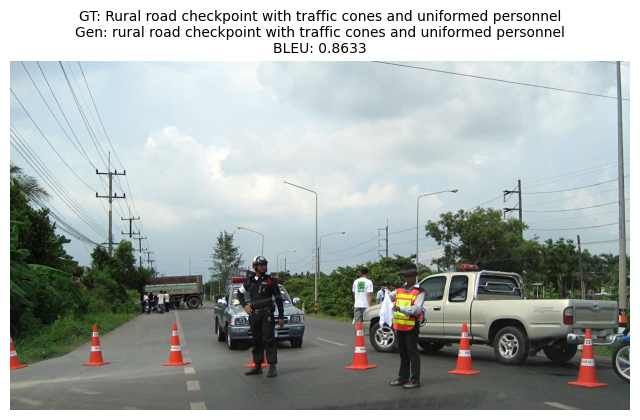

Evaluating Images:   8%|▊         | 5/59 [00:03<00:38,  1.41it/s]

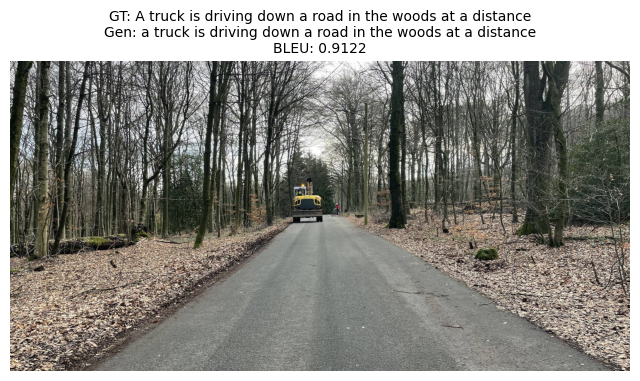

Evaluating Images:  10%|█         | 6/59 [00:04<00:39,  1.34it/s]

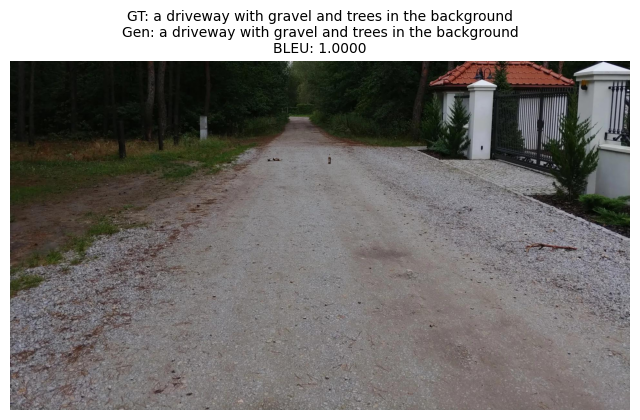

Evaluating Images:  12%|█▏        | 7/59 [00:05<00:38,  1.35it/s]

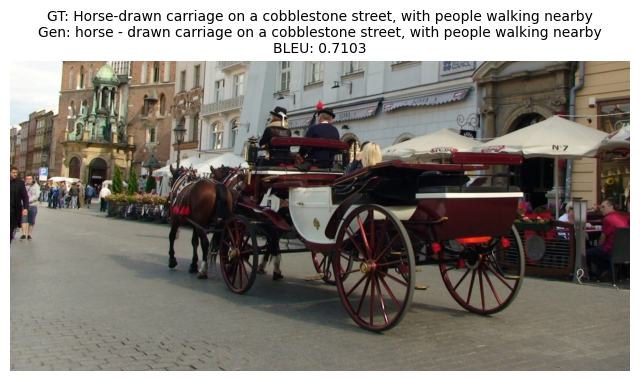

Evaluating Images:  14%|█▎        | 8/59 [00:06<00:39,  1.29it/s]

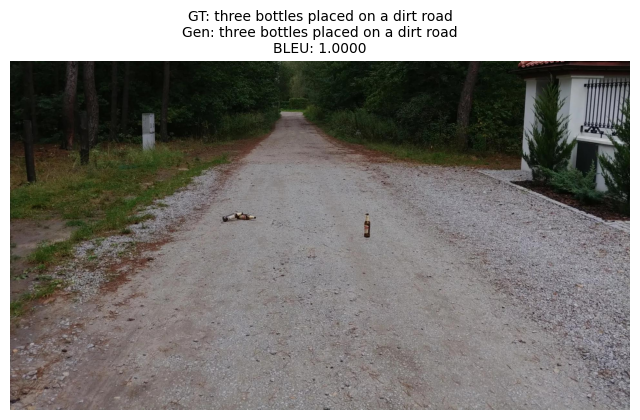

Evaluating Images:  15%|█▌        | 9/59 [00:07<00:38,  1.31it/s]

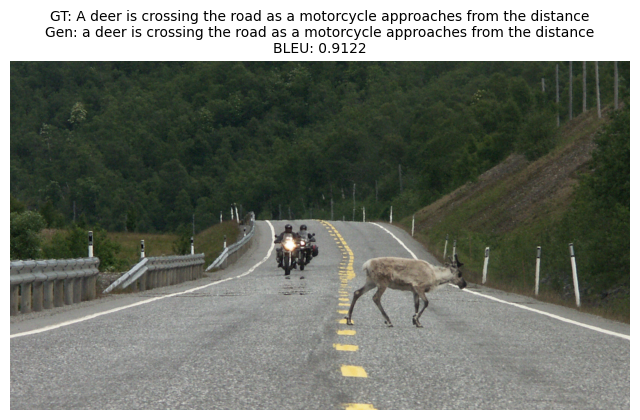

Evaluating Images:  17%|█▋        | 10/59 [00:07<00:36,  1.34it/s]

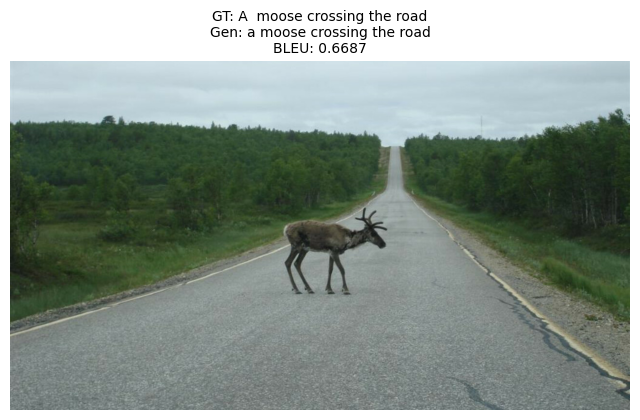

Evaluating Images:  19%|█▊        | 11/59 [00:08<00:33,  1.45it/s]

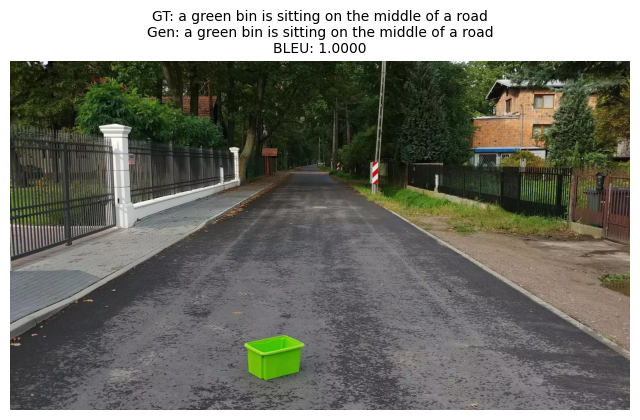

Evaluating Images:  20%|██        | 12/59 [00:09<00:32,  1.44it/s]

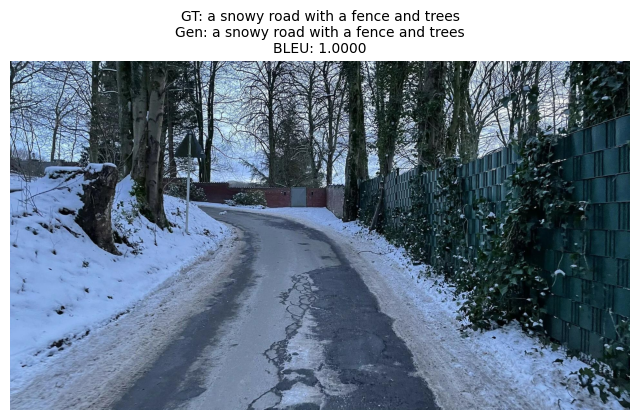

Evaluating Images:  22%|██▏       | 13/59 [00:09<00:32,  1.43it/s]

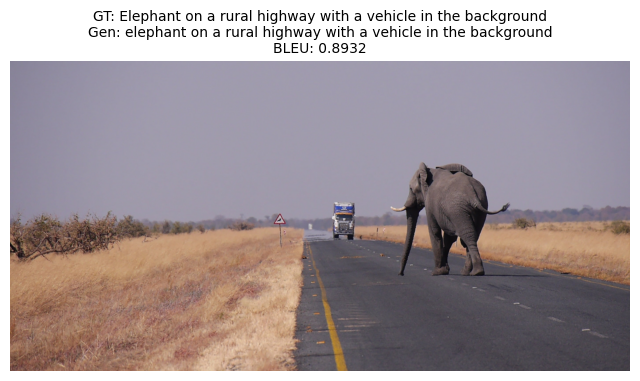

Evaluating Images:  24%|██▎       | 14/59 [00:10<00:34,  1.30it/s]

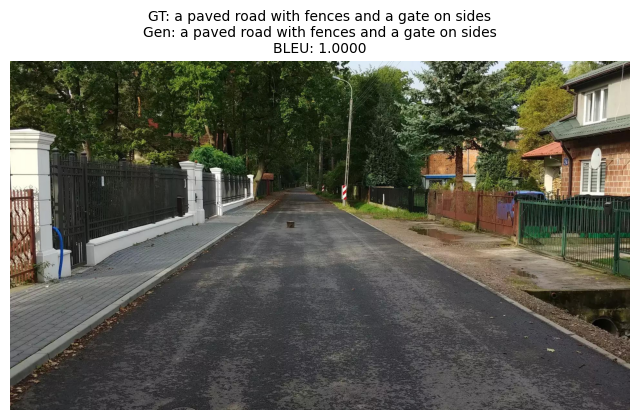

Evaluating Images:  25%|██▌       | 15/59 [00:11<00:36,  1.21it/s]

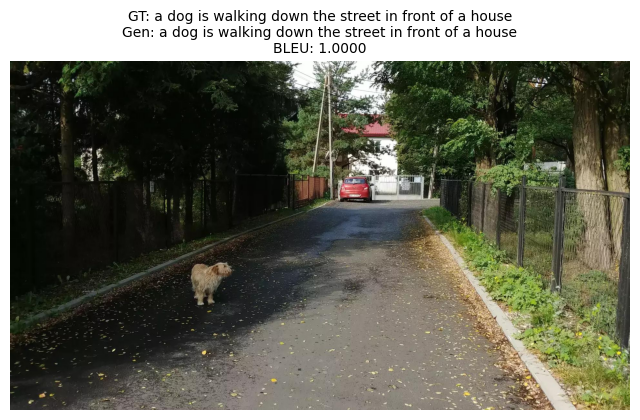

Evaluating Images:  27%|██▋       | 16/59 [00:12<00:37,  1.16it/s]

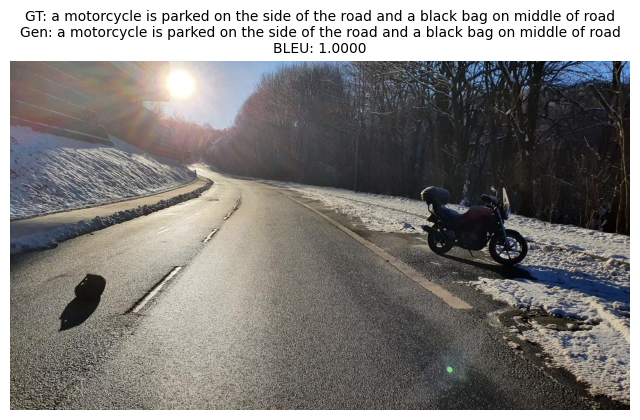

Evaluating Images:  29%|██▉       | 17/59 [00:13<00:40,  1.04it/s]

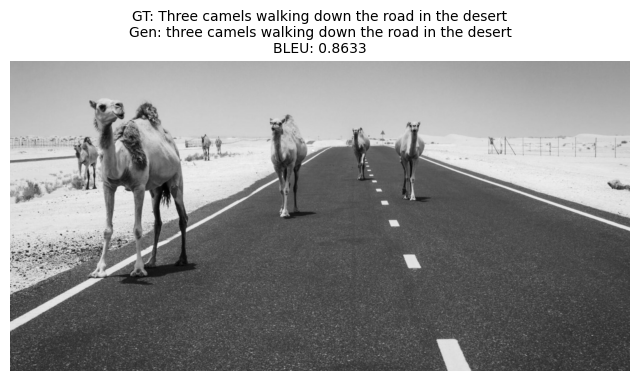

Evaluating Images:  31%|███       | 18/59 [00:14<00:38,  1.05it/s]

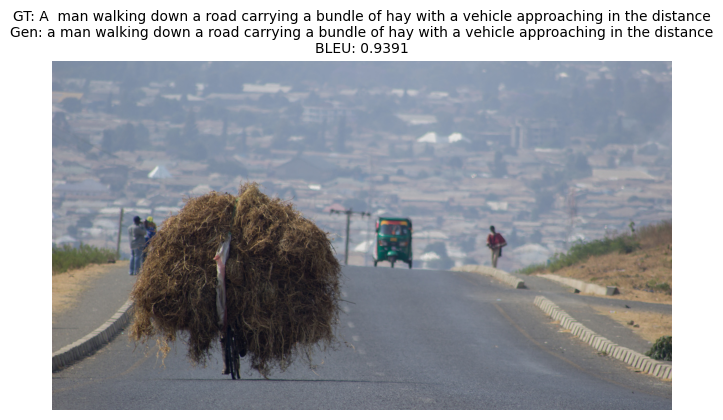

Evaluating Images:  32%|███▏      | 19/59 [00:15<00:38,  1.05it/s]

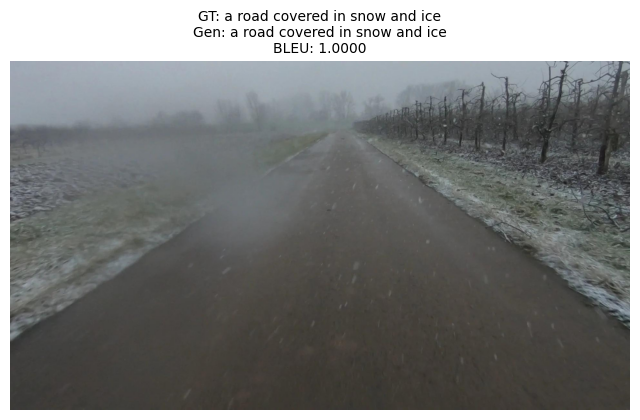

Evaluating Images:  34%|███▍      | 20/59 [00:16<00:34,  1.13it/s]

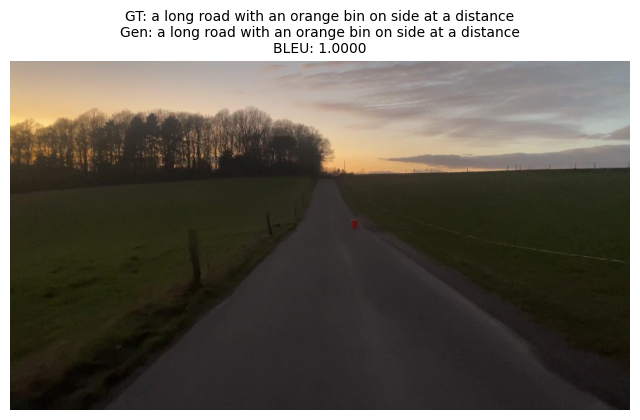

Evaluating Images:  36%|███▌      | 21/59 [00:17<00:32,  1.15it/s]

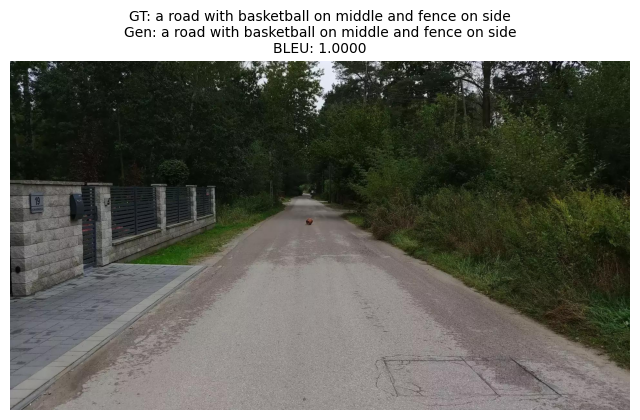

Evaluating Images:  37%|███▋      | 22/59 [00:17<00:29,  1.24it/s]

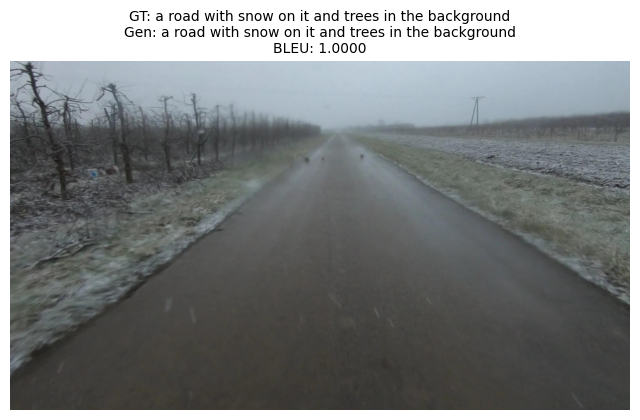

Evaluating Images:  39%|███▉      | 23/59 [00:18<00:28,  1.28it/s]

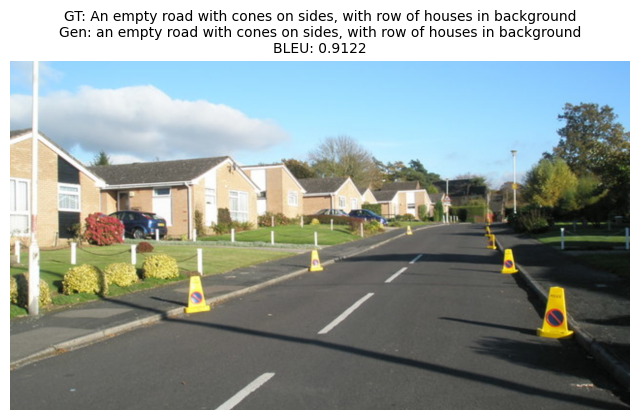

Evaluating Images:  41%|████      | 24/59 [00:19<00:26,  1.31it/s]

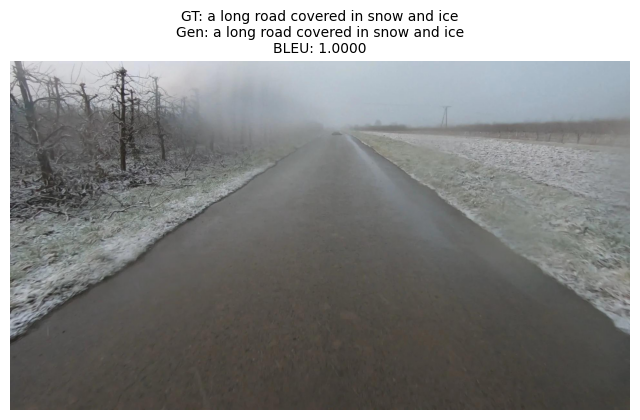

Evaluating Images:  42%|████▏     | 25/59 [00:20<00:29,  1.15it/s]

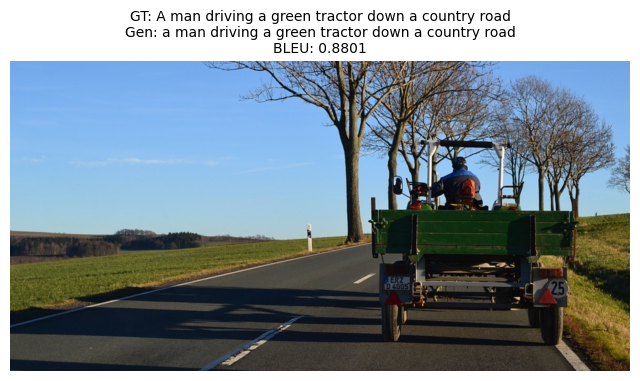

Evaluating Images:  44%|████▍     | 26/59 [00:21<00:27,  1.19it/s]

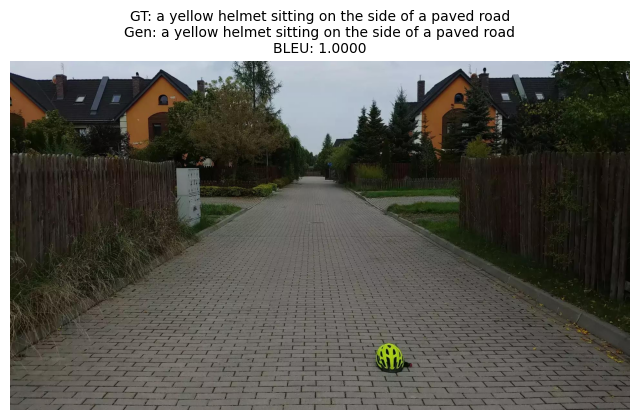

Evaluating Images:  46%|████▌     | 27/59 [00:21<00:25,  1.23it/s]

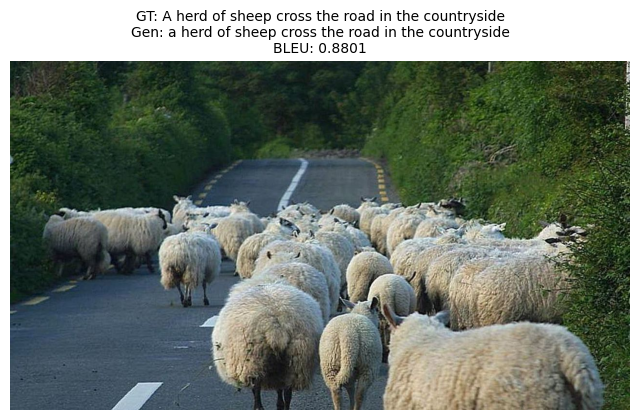

Evaluating Images:  47%|████▋     | 28/59 [00:22<00:24,  1.27it/s]

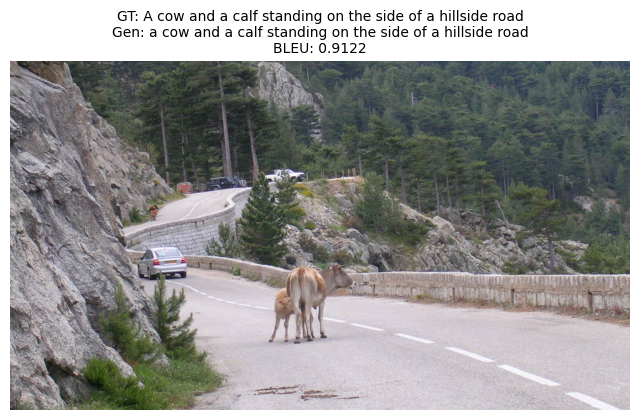

Evaluating Images:  49%|████▉     | 29/59 [00:23<00:23,  1.28it/s]

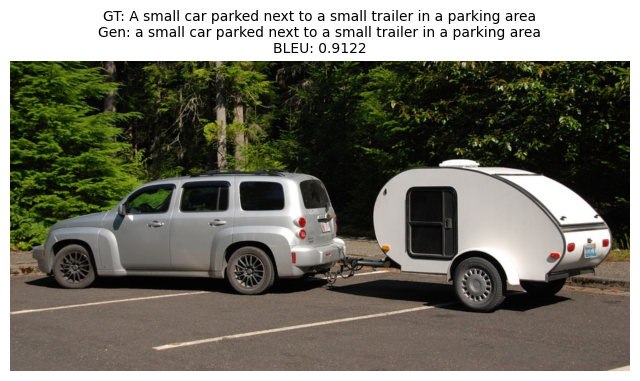

Evaluating Images:  51%|█████     | 30/59 [00:24<00:24,  1.17it/s]

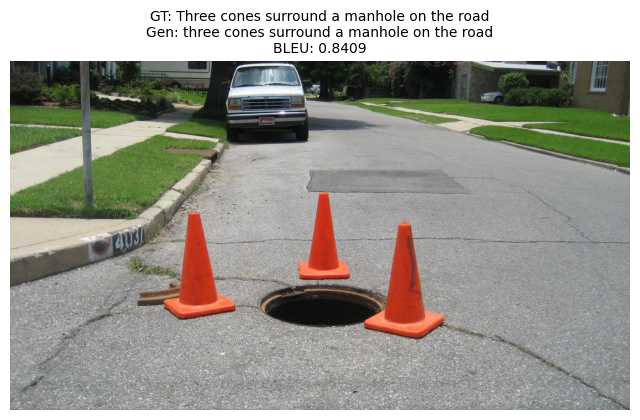

Evaluating Images:  53%|█████▎    | 31/59 [00:25<00:22,  1.22it/s]

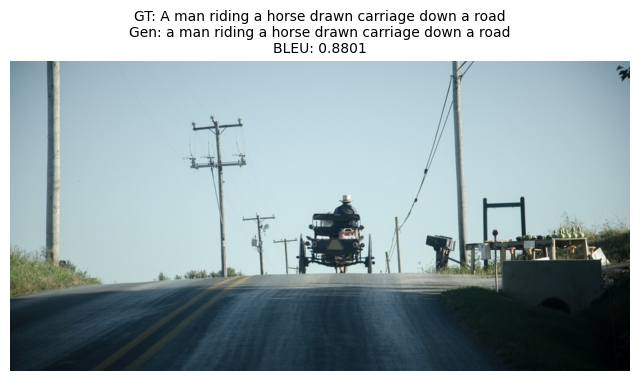

Evaluating Images:  54%|█████▍    | 32/59 [00:26<00:23,  1.17it/s]

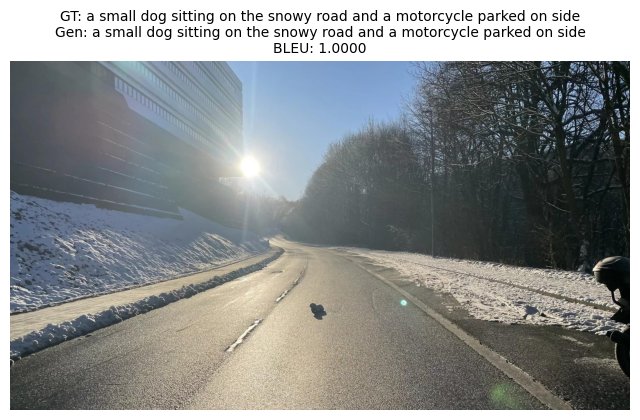

Evaluating Images:  56%|█████▌    | 33/59 [00:27<00:23,  1.08it/s]

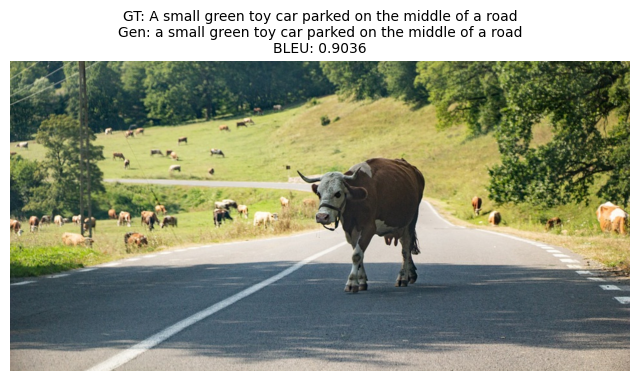

Evaluating Images:  58%|█████▊    | 34/59 [00:28<00:24,  1.02it/s]

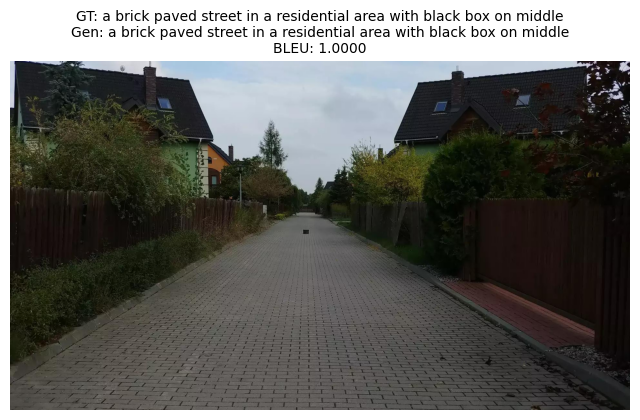

Evaluating Images:  59%|█████▉    | 35/59 [00:29<00:23,  1.02it/s]

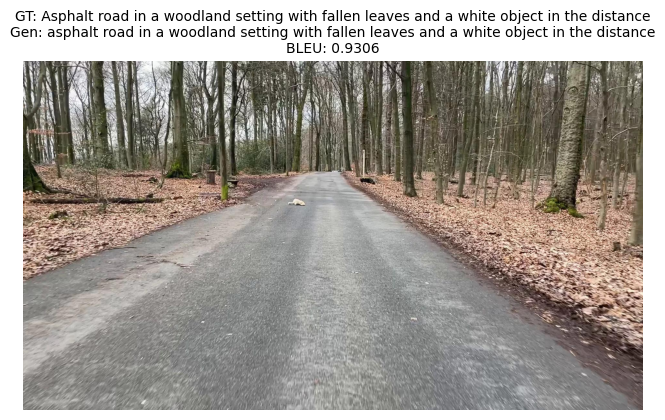

Evaluating Images:  61%|██████    | 36/59 [00:30<00:24,  1.05s/it]

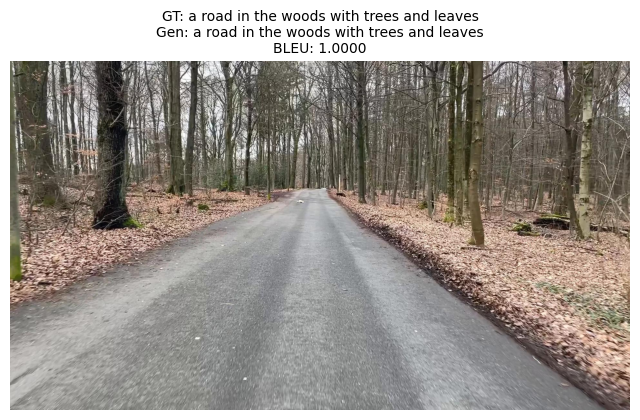

Evaluating Images:  63%|██████▎   | 37/59 [00:31<00:21,  1.03it/s]

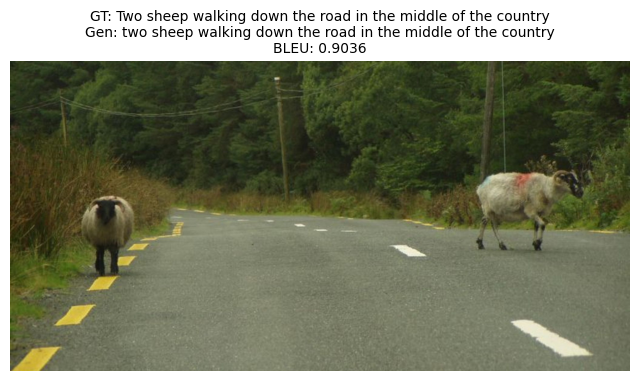

Evaluating Images:  64%|██████▍   | 38/59 [00:32<00:20,  1.04it/s]

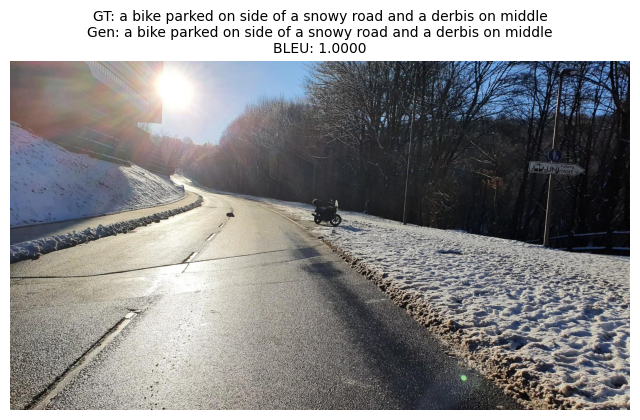

Evaluating Images:  66%|██████▌   | 39/59 [00:33<00:19,  1.05it/s]

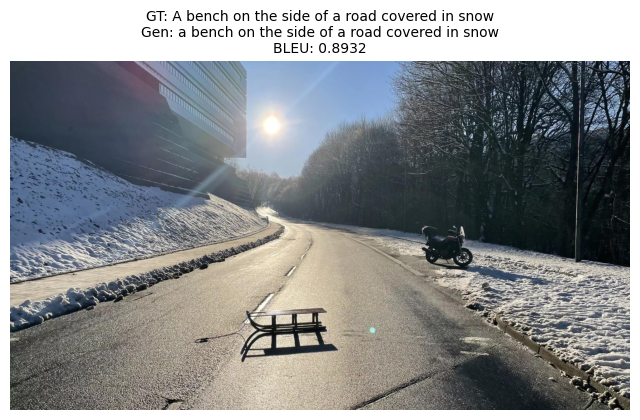

Evaluating Images:  68%|██████▊   | 40/59 [00:34<00:17,  1.07it/s]

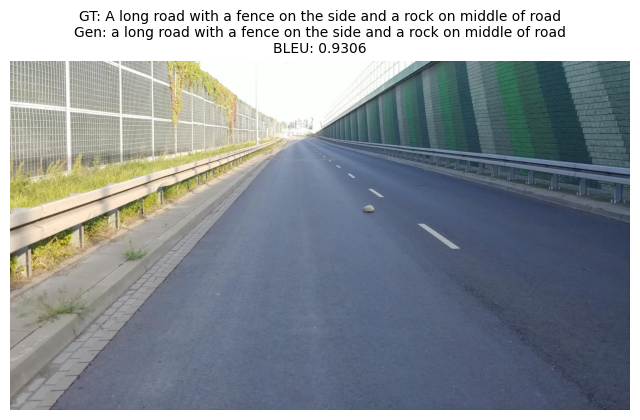

Evaluating Images:  69%|██████▉   | 41/59 [00:35<00:16,  1.06it/s]

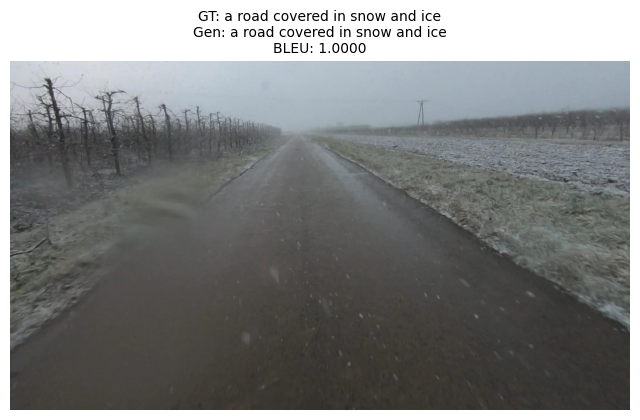

Evaluating Images:  71%|███████   | 42/59 [00:35<00:14,  1.15it/s]

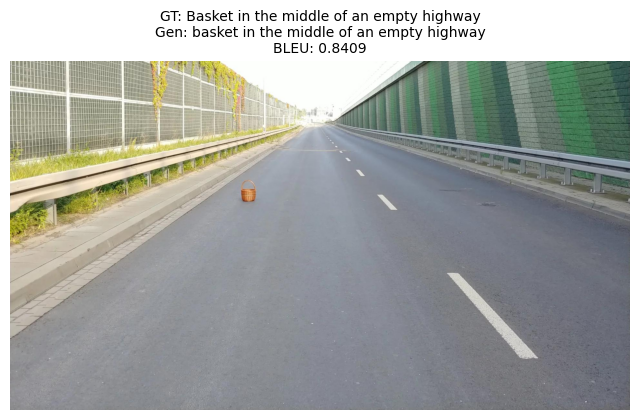

Evaluating Images:  73%|███████▎  | 43/59 [00:36<00:13,  1.18it/s]

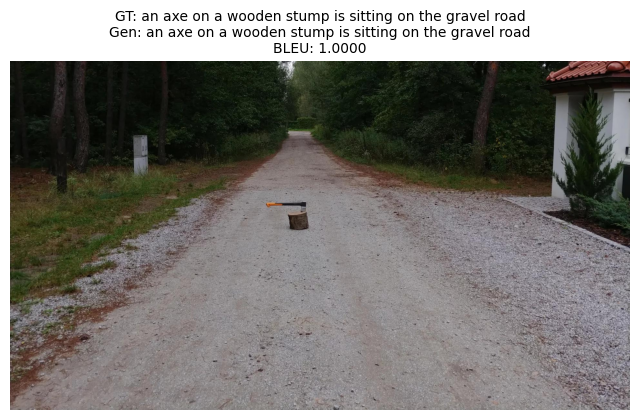

Evaluating Images:  75%|███████▍  | 44/59 [00:37<00:12,  1.16it/s]

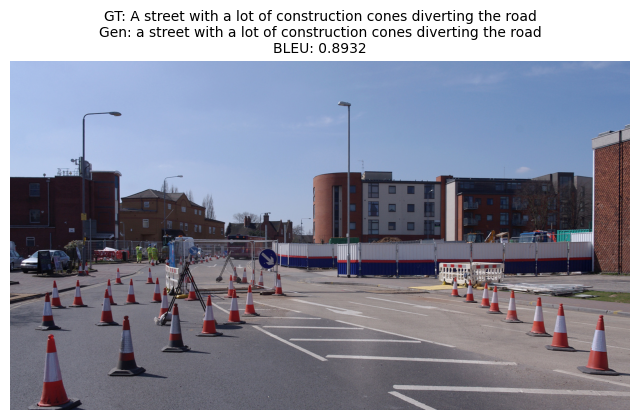

Evaluating Images:  76%|███████▋  | 45/59 [00:38<00:11,  1.19it/s]

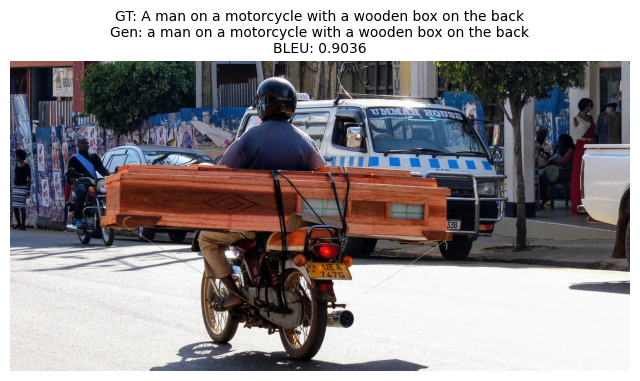

Evaluating Images:  78%|███████▊  | 46/59 [00:39<00:11,  1.16it/s]

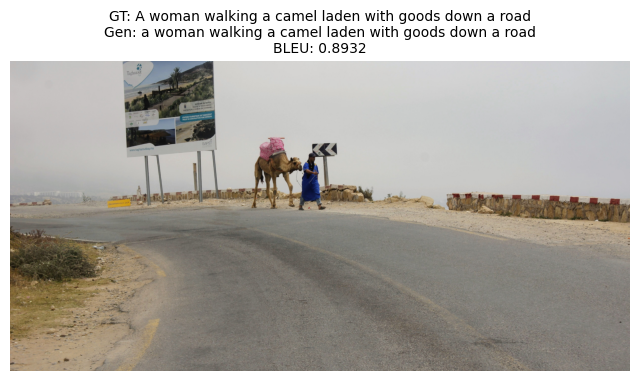

Evaluating Images:  80%|███████▉  | 47/59 [00:40<00:10,  1.14it/s]

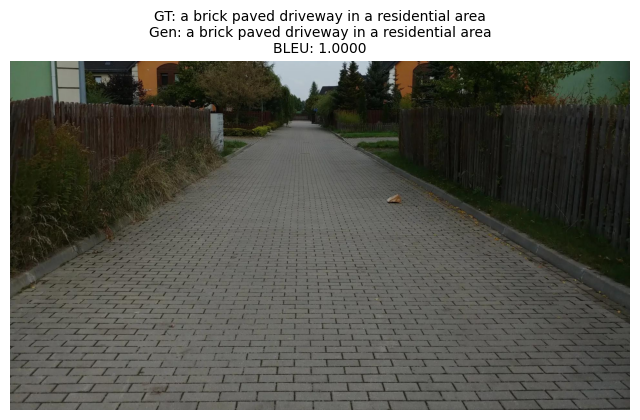

Evaluating Images:  81%|████████▏ | 48/59 [00:40<00:09,  1.16it/s]

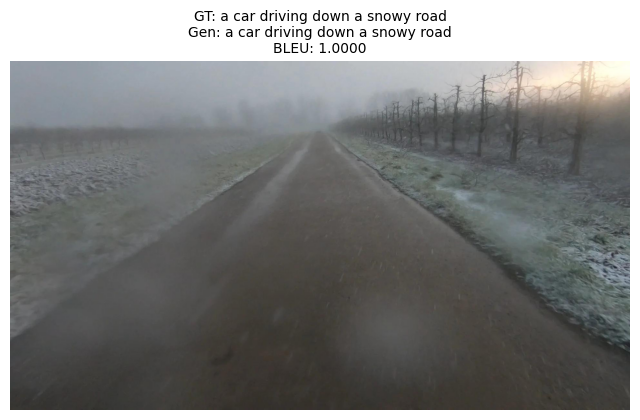

Evaluating Images:  83%|████████▎ | 49/59 [00:41<00:08,  1.18it/s]

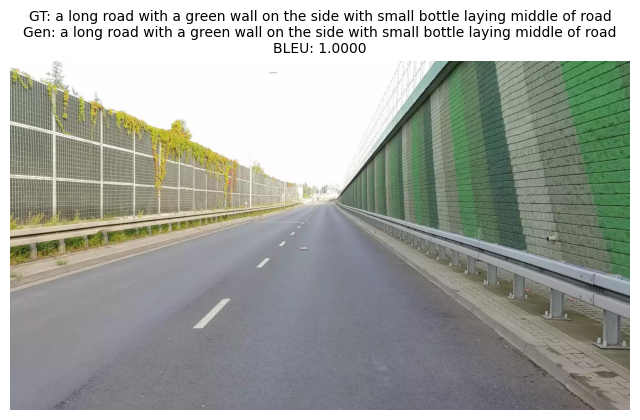

Evaluating Images:  85%|████████▍ | 50/59 [00:42<00:08,  1.11it/s]

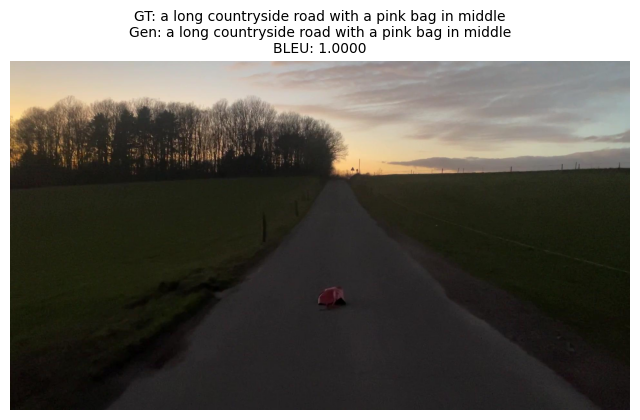

Evaluating Images:  86%|████████▋ | 51/59 [00:43<00:07,  1.12it/s]

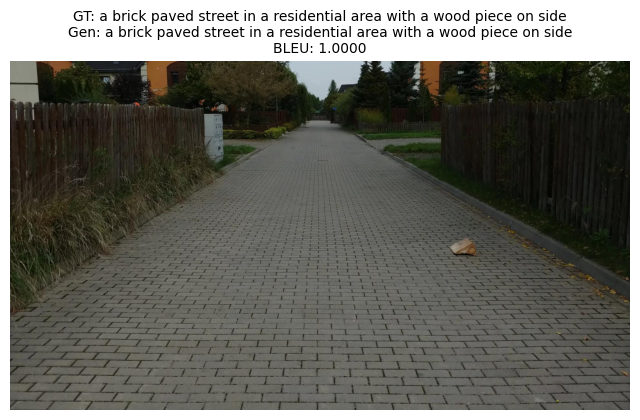

Evaluating Images:  88%|████████▊ | 52/59 [00:44<00:06,  1.06it/s]

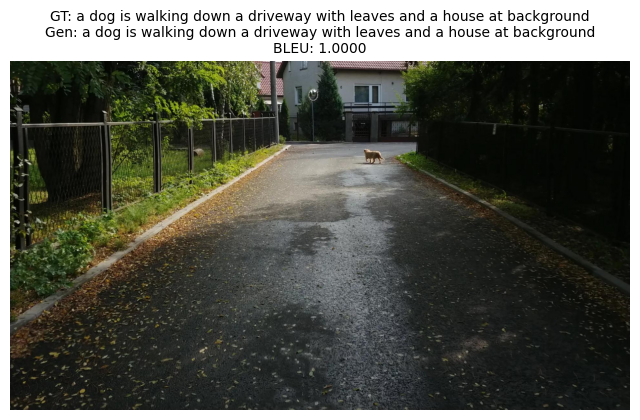

Evaluating Images:  90%|████████▉ | 53/59 [00:45<00:05,  1.01it/s]

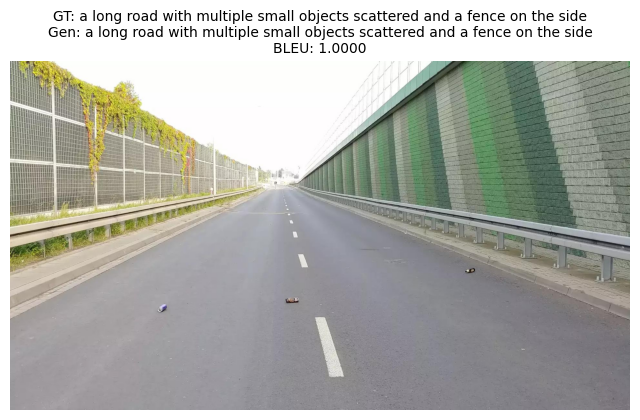

Evaluating Images:  92%|█████████▏| 54/59 [00:46<00:04,  1.01it/s]

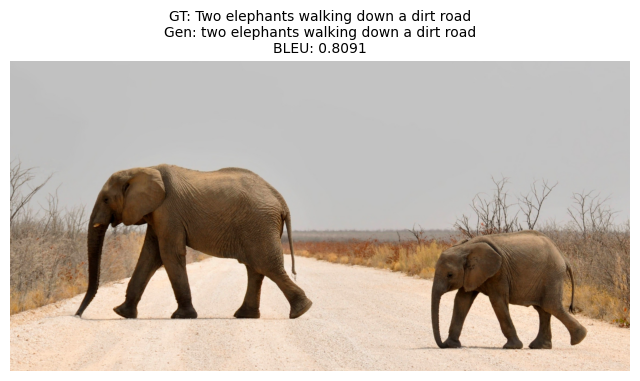

Evaluating Images:  93%|█████████▎| 55/59 [00:47<00:03,  1.07it/s]

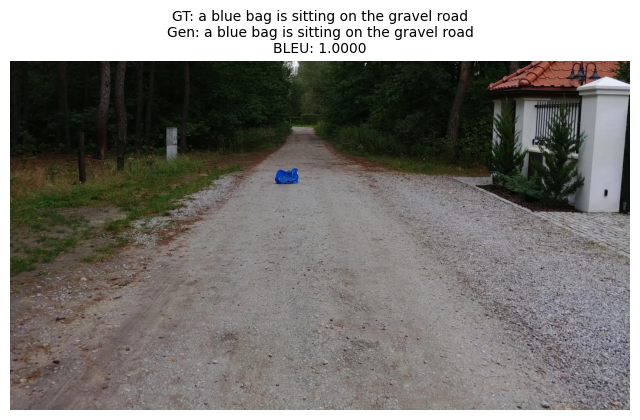

Evaluating Images:  95%|█████████▍| 56/59 [00:48<00:02,  1.09it/s]

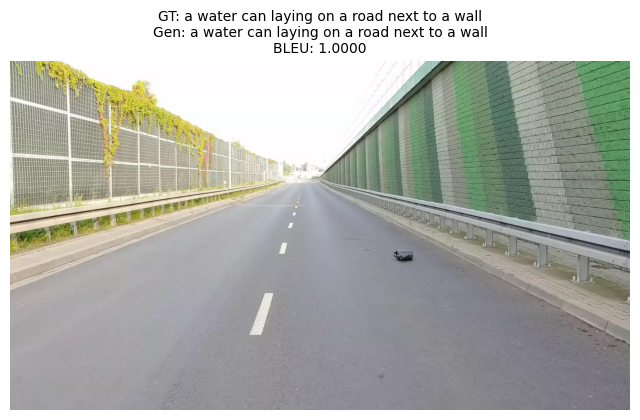

Evaluating Images:  97%|█████████▋| 57/59 [00:49<00:01,  1.11it/s]

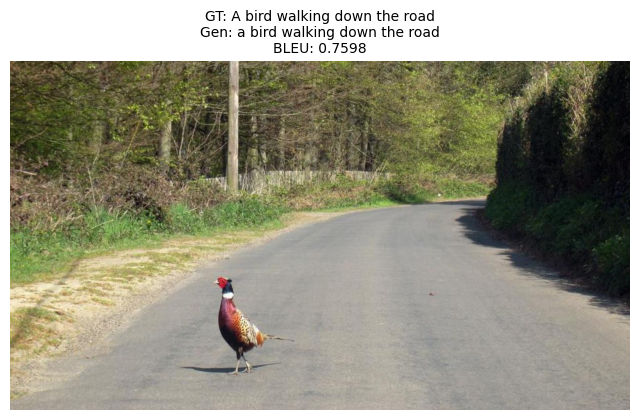

Evaluating Images:  98%|█████████▊| 58/59 [00:49<00:00,  1.22it/s]

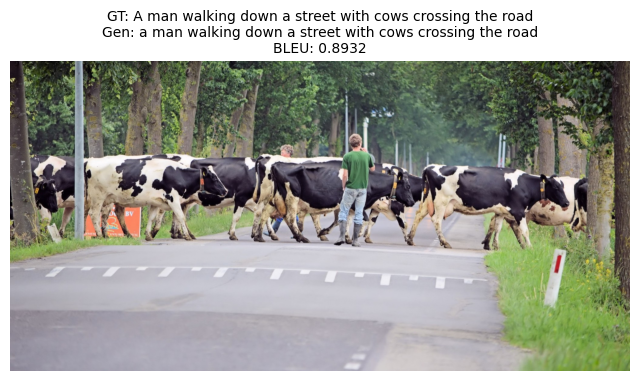

Evaluating Images: 100%|██████████| 59/59 [00:50<00:00,  1.16it/s]


--- Evaluation Summary ---
📊 Corpus BLEU Score: 0.9441


In [ ]:
evaluate_model(IMAGE_FOLDER, CAPTIONS_FILE, MODEL_PATH)